In [1]:
import sys
import os
os.environ["KMP_DUPLICATE_LIB_OK"]="TRUE"

from __future__ import print_function
#import Registration
import matplotlib.pyplot as plt
import cv2
from pyproj.transformer import Transformer, CRS
from rasterio.windows import from_bounds
from rasterio.transform import from_origin
from rasterio.warp import calculate_default_transform, reproject, Resampling
import shapefile as shp  # Requires the pyshp package
import geopandas as gpd
import rasterio
from rasterio.features import rasterize
from shapely.geometry import box
import torch

#install 'building_footprint_segmentation': https://github.com/fuzailpalnak/building-footprint-segmentation
from building_footprint_segmentation.seg.binary.models import DLinkNet34, ReFineNet 
from building_footprint_segmentation.helpers.normalizer import min_max_image_net
from building_footprint_segmentation.utils.py_network import (
    to_input_image_tensor,
    add_extra_dimension,
    convert_tensor_to_numpy,
    load_parallel_model,
    adjust_model
)
from torch.utils import model_zoo
from PIL import Image
import numpy as np

## 1. Set bounding box for the selected region (can be skipped)

In [2]:
my_bbox = (1741266.5569, 5870041.3036, 1741622.4668, 5870393.6305) # Input coordinates in EPSG:3857

## 2. Load shape file with building outlines

In [3]:
gdf = gpd.read_file("./sample_data/Maribor building outlines/Maribor building outlines/EDITED_24745_obrisi.shp")

## Plot shape file with building outlines (can be skipped)

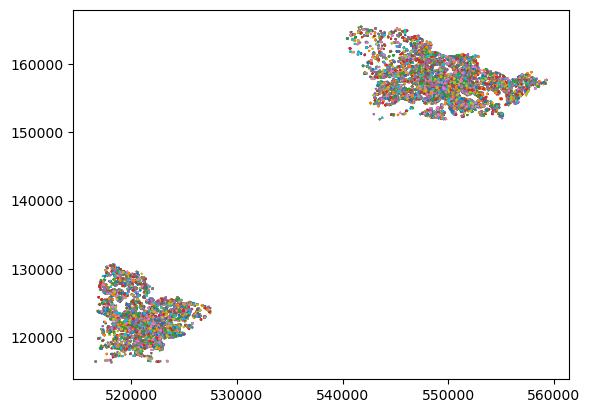

In [4]:
sf = shp.Reader("./sample_data/Maribor building outlines/Maribor building outlines/EDITED_24745_obrisi.shp")

plt.figure()
for shape in sf.shapeRecords():
    x = [i[0] for i in shape.shape.points[:]]
    y = [i[1] for i in shape.shape.points[:]]
    plt.plot(x,y)
plt.show()

## 3. Crop out shape layer inside the bounding box

549598.7700678537 157185.4193425933 1 1


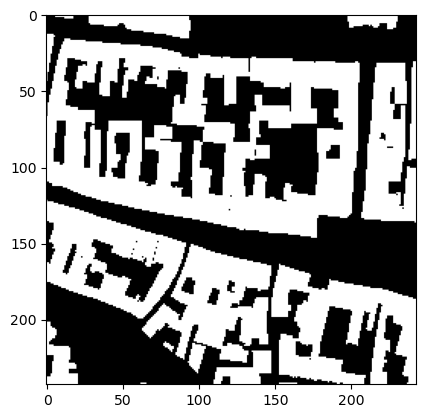

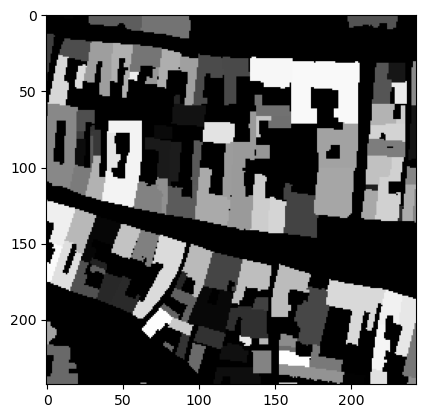

In [5]:
# Initialize the coordinate transformer
transformer = Transformer.from_crs("EPSG:3857", "EPSG:3912")

# Transform the coordinates to EPSG:3912
bbox = transformer.transform(my_bbox[0], my_bbox[1]) + transformer.transform(my_bbox[2], my_bbox[3])
minx, miny, maxx, maxy = bbox[0], bbox[1], bbox[2], bbox[3]

# Create a shapely box from the bounding box
bbox = box(*bbox)

# Crop to the bounding box
gdf_cropped = gdf[gdf.geometry.intersects(bbox)]

gdf_cropped.plot()

# Compute the average length of the sides of the polygons in the geodataframe
pixel_size = 1

# Define the transformation
#minx, miny, maxx, maxy = gdf_cropped.total_bounds
transform = from_origin(minx, maxy, pixel_size, pixel_size) # you need to define minx, miny and pixel_size

print(minx, miny, pixel_size, pixel_size)

# Define the raster size
raster_width = int((maxx - minx) / pixel_size)
raster_height = int((maxy - miny) / pixel_size)

# Initialize a raster array with the correct size, filled with zeros
out_raster = np.zeros((raster_height, raster_width))

# Burn the features into the raster array
out_raster = rasterize(shapes=gdf_cropped['geometry'], transform=transform, out_shape=out_raster.shape, fill=0, default_value=1)

# Create color raster with each bouilding having it's own color
colored_out_raster = np.zeros(out_raster.shape, dtype=np.uint16)

for geometry_index, geometry in enumerate(gdf_cropped['geometry']):
    color_value = geometry_index + 1
    rasterized_geometry = rasterize([(geometry, color_value)], transform=transform, out_shape=colored_out_raster.shape)
    
    #old option:
    #colored_out_raster += rasterized_geometry
    
    #new option:
    colored_out_raster[colored_out_raster == 0] += rasterized_geometry[colored_out_raster == 0]

plt.imshow(out_raster, cmap='gray')
plt.show()

plt.imshow(colored_out_raster, cmap='gray') #TOTO slikico uporabi za bbox-e vsake bajte
plt.show()

## 4. Load raster layer

In [6]:
fp = './sample_data/maribor_center_epsg3857.tif'
src = rasterio.open(fp)

## 5. Crop out raster layer inside the bounding box

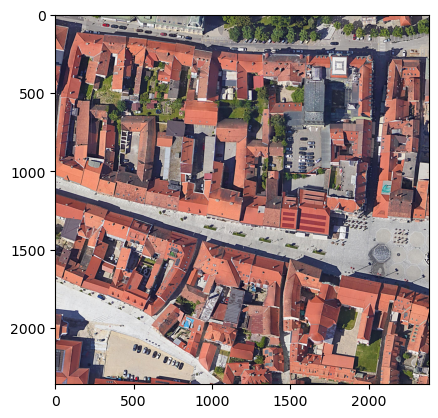

In [7]:
# Convert the bounding box to a rasterio window
window = from_bounds(my_bbox[0], my_bbox[1], my_bbox[2], my_bbox[3], src.transform)

# Read the data from the window
subset = src.read(1, window=window)

cropped_raster = np.zeros((subset.shape[0], subset.shape[1], 3), dtype=np.uint8)
cropped_raster[:,:,0] = src.read(1, window=window)
cropped_raster[:,:,1] = src.read(2, window=window)
cropped_raster[:,:,2] = src.read(3, window=window)

plt.imshow(cropped_raster)
plt.show()

## 6. Rescale shape layer inside bounding box to same size as raster layer

In [8]:
cropped_shp = cv2.resize(out_raster, (cropped_raster.shape[1], cropped_raster.shape[0]), interpolation = cv2.INTER_NEAREST) * 255
cropped_shp_colored = cv2.resize(colored_out_raster, (cropped_raster.shape[1], cropped_raster.shape[0]), interpolation = cv2.INTER_NEAREST)

## 7. Building footprint edge detection

In [9]:
high_treshold = 255
low_threshold = high_treshold // 3

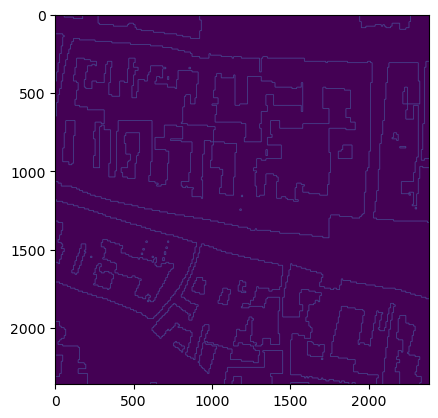

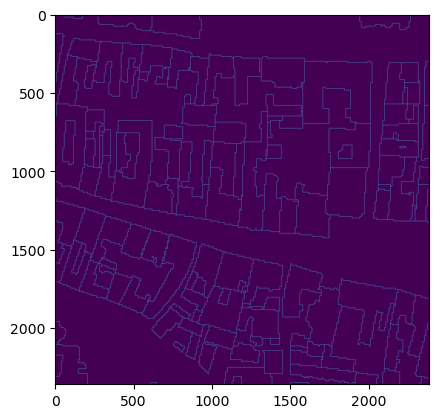

In [10]:
cropped_shp_edges = cv2.Canny(cropped_shp,low_threshold,high_treshold)

plt.imshow(cropped_shp_edges)
plt.show()

#16 bit each house edge detection
cropped_shp_edges_colored = np.zeros(cropped_shp_edges.shape, dtype=cropped_shp_edges.dtype)

for val in np.unique(cropped_shp_colored):
    if val == 0: #skip background
        continue
        
    copy_colored_out_raster1 = np.zeros(cropped_shp_colored.shape, dtype=np.uint8)
    copy_colored_out_raster1[cropped_shp_colored == val] = 255
    
    copy_colored_out_raster1_edges = cv2.Canny(copy_colored_out_raster1,low_threshold,high_treshold)
    
    cropped_shp_edges_colored[copy_colored_out_raster1_edges == 255] = 255
    
plt.imshow(cropped_shp_edges_colored)
plt.show()

## 8. Recognize building footprints

In [11]:
def get_model():
    model = ReFineNet() #DLinkNet34() <- worse model, ReFineNet is better
    state_dict = model_zoo.load_url(r"https://github.com/fuzailpalnak/building-footprint-segmentation/releases/download/alpha/refine.zip") #model_zoo.load_url(r"https://github.com/fuzailpalnak/building-footprint-segmentation/releases/download/v0.2.3/DlinkNet.zip", progress=True, map_location="cpu")
    if "model" in state_dict:
        state_dict = state_dict["model"]
    state_dict = adjust_model(state_dict)
    model.load_state_dict(state_dict)
    return model

model = get_model()
model.eval()

C:\Users\Domen\anaconda3\envs\deep_learning_pytorch2.0\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
C:\Users\Domen\anaconda3\envs\deep_learning_pytorch2.0\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet34_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet34_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
C:\Users\Domen\anaconda3\envs\deep_learning_pytorch2.0\lib\site-packages\torch\hub.py:665: UserWarning: Falling back to the old format < 1.6. This support will be deprecated in favor of default zipfile format introduced in 1.6. Please redo torch.save() to save it in the new zipfile format.
  warnings.warn('Fal

ReFineNet(
  (layer0): Sequential(
    (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  )
  (layer1): Sequential(
    (0): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu

### Prepare input

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


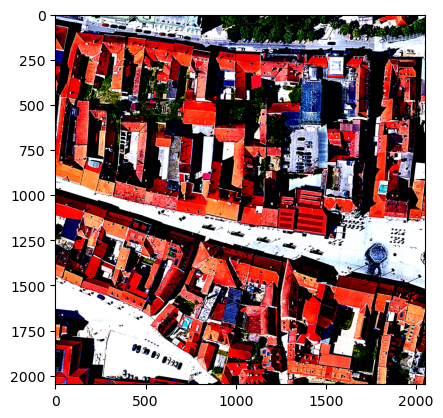

In [12]:
original_image = np.array(cropped_raster)[:, :, :]
original_width = original_image.shape[0]
original_height = original_image.shape[1]

original_image = cv2.resize(original_image, (2048, 2048), interpolation = cv2.INTER_AREA)

image = min_max_image_net(img=original_image)
image = np.expand_dims(image, 0)

plt.imshow(image[0])
plt.show()

h, w, _ = original_image.shape
number_of_output_channels = 1

### Recognize building footprints

In [13]:
tensor_image = to_input_image_tensor(image).swapaxes(0, 1)
roof_treshold = 0.9

with torch.no_grad():
    # Perform prediction
    prediction = model(tensor_image)
    
    prediction = prediction.sigmoid()[0,0,:,:]
    
    rooftop_binary = (convert_tensor_to_numpy(prediction) > roof_treshold).astype(np.uint8) * 255
    rooftop_binary = cv2.resize(rooftop_binary, (original_height, original_width), interpolation = cv2.INTER_NEAREST)

### Perform closing on the recognized building footprints

In [14]:
rooftop_binary = cv2.morphologyEx(rooftop_binary, cv2.MORPH_CLOSE, np.ones((5, 5), np.uint8), iterations = 3)

### Manually edit/correct predictions of rooftops OR load previous corrections

In [15]:
manually_correct_and_save = True
saved_image_path = 'rooftop_binary.png'

In [16]:
if manually_correct_and_save is True:
    from ipycanvas import Canvas, hold_canvas, MultiCanvas
    from ipywidgets import VBox, Button, Image, HBox, Widget
    from PIL import Image as PILImage
    import time
    import numpy as np
    from io import BytesIO
    import imageio
    from IPython.display import display

    def set_opacity(input_image, opacity):
        """ Adjusts the alpha channel of an image """
        img = input_image.convert("RGBA")
        data = img.getdata()

        newData = []
        for item in data:
            newData.append((item[0], item[1], item[2], opacity))
        img.putdata(newData)
        return img

    # Convert the RGB and binary images to Image widgets
    def numpy_to_image_widget(numpy_array, opacity=255):
        pil_image = PILImage.fromarray(numpy_array)
        pil_image = set_opacity(pil_image, opacity)
        buf = BytesIO()
        pil_image.save(buf, format='png')
        binary_image_data = buf.getvalue()
        return Image(value=binary_image_data, format='png')

    # Create and display an Image widget
    opacity = 105

    rooftop_binary_for_widget = cv2.resize(rooftop_binary, (768, 768), interpolation = cv2.INTER_NEAREST)
    cropped_raster_for_widget = cv2.resize(cropped_raster, (768, 768), interpolation = cv2.INTER_LINEAR)

    binary_image_widget = numpy_to_image_widget(rooftop_binary_for_widget, opacity=opacity)
    rgb_image_widget = numpy_to_image_widget(cropped_raster_for_widget)

    # Create a multi-layered canvas: one layer for the image, another for drawings
    canvas = MultiCanvas(3, width=rooftop_binary_for_widget.shape[1], height=rooftop_binary_for_widget.shape[0])

    # Display the image on the first layer
    canvas[0].draw_image(binary_image_widget, 0, 0)
    canvas[1].draw_image(rgb_image_widget, 0, 0)
    canvas[2].draw_image(binary_image_widget, 0, 0)
    canvas[2].sync_image_data = True

    drawing = False

    # Define drawing event handlers
    def on_mouse_down(x, y):
        global drawing
        drawing = True
        canvas[2].fill_style = canvas[2].stroke_style  # Use the current stroke color as fill color
        canvas[2].fill_arc(x, y, 10/2, 0, 2 * np.pi)  # Draw a circle with radius 5 (half of 10)

    def on_mouse_up(x, y):
        global drawing
        drawing = False

    def on_mouse_move(x, y):
        if not drawing:
            return
        canvas[2].fill_style = canvas[2].stroke_style
        canvas[2].fill_arc(x, y, 10/2, 0, 2 * np.pi)

    canvas[2].on_mouse_down(on_mouse_down)
    canvas[2].on_mouse_up(on_mouse_up)
    canvas[2].on_mouse_move(on_mouse_move)

    # Color switching buttons
    def set_black(b):
        canvas[2].stroke_style = 'black'#f'rgba(0,0,0,{opacity/255})'

    def set_white(b):
        canvas[2].stroke_style = 'white'#f'rgba(255,255,255,1.0)'

    black_button = Button(description="Set Black")
    black_button.on_click(set_black)
    white_button = Button(description="Set White")
    white_button.on_click(set_white)

    # Save button
    saved_image = None

    def save_image(b):
        global saved_image

        # Ensure all drawings are completed
        with hold_canvas(canvas[2]):
            canvas[2].flush()

        # Give a small delay to allow the front-end to synchronize with the back-end
        time.sleep(1)

        # Explicitly ask for a sync of all widget states
        #Widget.sync_all()

        data = canvas[2].get_image_data()
        data[data > 0] = 255 #set white to 255
        data[data == 0] = 0 #set black to 0
        pil_img = PILImage.fromarray(np.uint8(data))

        saved_image = np.array(pil_img)
        saved_image = saved_image[:, :, 2]
        saved_image = cv2.resize(saved_image, (original_height, original_width), interpolation = cv2.INTER_NEAREST)
        
        imageio.imsave(saved_image_path, saved_image)
        print("Saved image to: " + saved_image_path  +"! - (Maybe press 'save' a few more times just to get the latest version of image - just to be safe :D)")

    save_button = Button(description="Save Image")
    save_button.on_click(save_image)

    # Button to clear the drawing layer
    def clear_drawing(b):
        canvas[2].clear()

    clear_button = Button(description="Clear Drawing")
    clear_button.on_click(clear_drawing)

    box = VBox([HBox([black_button, white_button]), canvas, save_button, clear_button])
    display(box)
else:
    print("Skipping manual correction of binary mask!")

## Load binary mask

Loaded image from: rooftop_binary.png


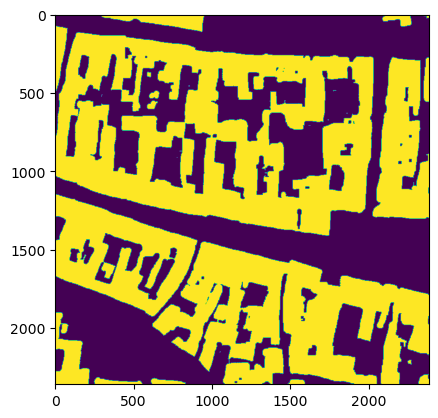

In [17]:
loaded_rooftop_binary = imageio.v2.imread(saved_image_path)
print("Loaded image from:", saved_image_path)
rooftop_binary = np.array(loaded_rooftop_binary)

plt.imshow(rooftop_binary)
plt.show()

### Save rooftop binary in a new variable

In [18]:
rooftop_binary_morph = np.array(rooftop_binary)

### Recognize edges of recognized building footprints

In [19]:
rooftop_binary_morph_edges = cv2.Canny(rooftop_binary_morph,low_threshold,high_treshold)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


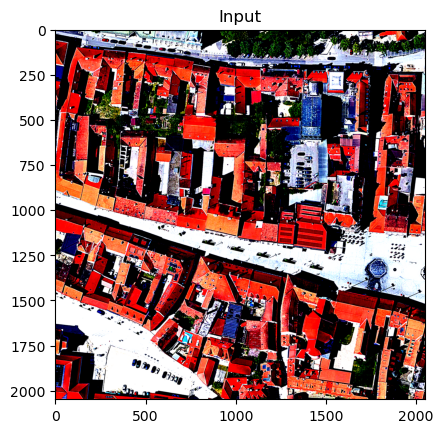

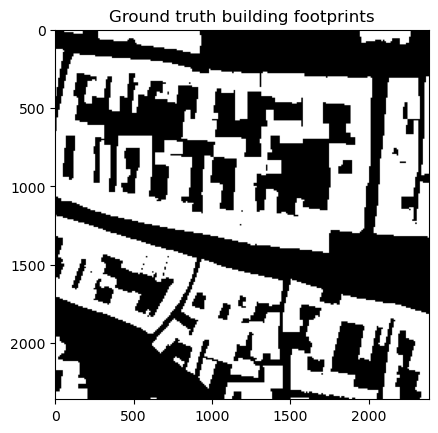

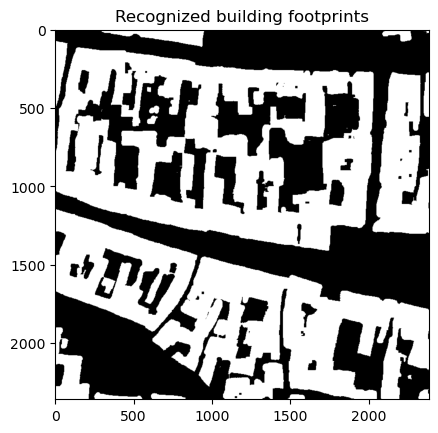

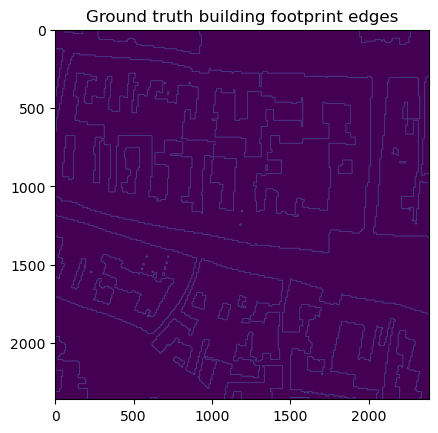

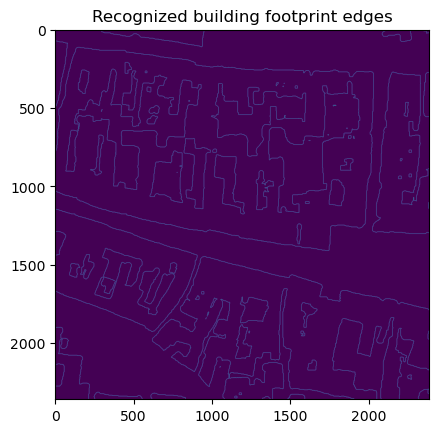

In [20]:
plt.title("Input")
plt.imshow(image[0])
plt.show()

plt.title("Ground truth building footprints")
plt.imshow(cropped_shp[:, :], 'gray')
plt.show()

plt.title("Recognized building footprints")
plt.imshow(rooftop_binary_morph, 'gray')
plt.show()

plt.title("Ground truth building footprint edges")
plt.imshow(cropped_shp_edges)
plt.show()

plt.title("Recognized building footprint edges")
plt.imshow(rooftop_binary_morph_edges)
plt.show()

## 9. ICP (get transformation matrix between ground truth and recognized building footprint edges)

In [21]:
from sklearn.neighbors import NearestNeighbors

In [240]:
def nearest_neighbor(src, dst):
    """ Find the nearest (Euclidean) neighbor in dst for each point in src. """
    indices = []
    for s in src:
        min_dist = float('inf')
        index = 0
        for i, d in enumerate(dst):
            dist = np.linalg.norm(s-d)
            if dist < min_dist:
                min_dist = dist
                index = i
        indices.append(index)
    return indices

#scale-adaptive ICP #koda iz predzadnjega odgovora na: https://chat.openai.com/c/25f57660-384e-4335-a112-9afa07fb6a2d (ko rečem botu, da koda deluje veliko bolje, ampak.... .)
def closest_point(source_points, target_points):
    """
    For each point in source_points, find the closest point in target_points.
    """
    correspondences = []
    for src in source_points:
        distances = np.linalg.norm(target_points - src, axis=1)
        closest_point_index = np.argmin(distances)
        correspondences.append(target_points[closest_point_index])
    return np.array(correspondences)

def compute_optimal_rotation(A, B):
    H = np.dot(A.T, B)
    U, _, Vt = np.linalg.svd(H)
    R = np.dot(Vt.T, U.T)
    return R

def scale_adaptive_ICP(source_points, target_points, iterations=10, tol=1e-6, silent_mode=False):
    N = source_points.shape[0]
    
    src = np.copy(source_points)

    for _ in range(iterations):
        # Step 1: Find closest points or correspondences
        #indices = nearest_neighbor(src, target_points)
        #correspondences = np.array([target_points[i] for i in indices]) #my modification
        correspondences = closest_point(src, target_points) #original
        
        # Compute centroids
        centroid_source = np.mean(src, axis=0)
        centroid_correspondences = np.mean(correspondences, axis=0)

        # Center the point sets
        centered_source = src - centroid_source
        centered_correspondences = correspondences - centroid_correspondences

        # Step 2: Compute the optimal rotation
        R = compute_optimal_rotation(centered_source, centered_correspondences)

        # Compute scale
        s = np.sum(np.linalg.norm(np.dot(centered_source, R) - centered_correspondences, axis=1)) / np.sum(np.linalg.norm(centered_source)**2)
        
        # Compute translation
        T = centroid_correspondences - s * np.dot(centroid_source, R)

        # Update the source points with the found transformations
        src = s * np.dot(src, R.T) + T
        
        # Compute the error
        error = np.mean(np.linalg.norm(source_points - correspondences, axis=1))
        
        if error < tol:
            break
            
        if silent_mode is False:
            print("i-th iteration:", (_+1), "/", iterations, "error:", error)

    return R, T, s

#laplacian ICP -> odgovor/koda: https://chat.openai.com/c/5362efdd-d60f-496e-bb39-a64525f32e39
def laplacian_matrix(points, k=5):
    """
    Calculates the Laplacian matrix for a set of points.
    """
    # Calculate the k-nearest neighbors
    nbrs = NearestNeighbors(n_neighbors=k, algorithm='auto').fit(points)
    distances, indices = nbrs.kneighbors(points)

    # Construct the adjacency matrix W
    n = points.shape[0]
    W = np.zeros((n, n))
    for i in range(n):
        for j in indices[i, :]:
            W[i, j] = np.exp(-np.linalg.norm(points[i] - points[j])**2)  # Gaussian kernel, you might want to adjust this
    # Ensure symmetry
    W = 0.5 * (W + W.T)

    # Construct the diagonal matrix D
    D = np.diag(np.sum(W, axis=1))

    # Compute the Laplacian matrix L
    L = D - W

    return L

def best_fit_transform_laplacian(A, B, L_A, L_B):
    """
    Calculates the best-fit transform that maps corresponding points A to B
    for m-dimensional points.
    """
    
    L_A = np.diag(L_A.sum(axis=1))
    L_B = np.diag(L_B.sum(axis=1))
    
    
    # Get the number of dimensions
    m = A.shape[1]

    # Calculate centroid of both sets
    centroid_A = np.mean(A, axis=0)
    centroid_B = np.mean(B, axis=0)

    # Center the points
    A_centered = A - centroid_A
    B_centered = B - centroid_B

    # Calculate the covariance matrix
    H = A_centered.T @ L_A @ B_centered + B_centered.T @ L_B @ A_centered  # Adjusted calculation

    # Calculate the Singular Value Decomposition (SVD)
    U, _, Vt = np.linalg.svd(H)

    # Calculate the rotation matrix
    R = Vt.T @ U.T

    # Ensure proper orientation by correcting for reflection case
    if np.linalg.det(R) < 0:
        Vt[-1, :] *= -1
        R = Vt.T @ U.T

    # Calculate the translation matrix
    T = centroid_B - R @ centroid_A

    return R, T

def icp_laplacian(A, B, max_iterations=20, tolerance=1e-10, silent_mode=False, lambda_reg=0.1):
    """
    The Iterative Closest Point method: Modified version for m-dimensional points.
    """
    print("Performing laplacian ICP...")
    
    src = np.copy(A)
    prev_error = 0

    # Calculate Laplacian matrices
    k = 5
    if A.shape[0] < k:
        k = A.shape[0]
    L_A = laplacian_matrix(A, k=k)
    
    k = 5
    if B.shape[0] < k:
        k = B.shape[0]
    L_B = laplacian_matrix(B, k=k)

    # Initialize cumulative rotation as the identity and translation as zero
    R_cumulative = np.eye(A.shape[1])
    T_cumulative = np.zeros(A.shape[1])

    # ... [rest of your icp function]

    for i in range(max_iterations):
        indices = nearest_neighbor(src, B)

        # Select the subset of B that corresponds to the nearest neighbors of src
        B_matched = np.array([B[i] for i in indices])

        # Now calculate the Laplacian matrices for the current src and B_matched
        try:
            L_A_current = laplacian_matrix(src)
            L_B_matched = laplacian_matrix(B_matched)
        except:
            print("Error in calculating laplacian matrix... Skipping this call.")
            return None, None

        # Ensure L_A_current and L_B_matched have the same shape
        if L_A_current.shape != L_B_matched.shape:
            print(f"Error: Laplacian matrices' shapes do not match: {L_A_current.shape} vs {L_B_matched.shape}")
            return None, None

        R, T = best_fit_transform(src, B_matched)

        src = (R @ src.T).T + T

        # Accumulate the transformation
        T_cumulative = R @ T_cumulative + T
        R_cumulative = R @ R_cumulative

        # Calculate the current error as the mean Euclidean distance between the transformed src and B_matched
        current_error = np.mean(np.linalg.norm(src - B_matched, axis=1))  # This line calculates the current_error

        # Calculate the difference from the Laplacian matrices
        laplacian_error = np.linalg.norm(L_A_current - L_B_matched, 'fro')

        # Total error combines the matching error and the Laplacian regularization error
        total_error = current_error + lambda_reg * laplacian_error

        if abs(prev_error - total_error) < tolerance:
            break
        prev_error = total_error

        if silent_mode is False:
            print("i-th iteration:", (i+1), "/", max_iterations, "error:", prev_error)

    # ...


    return R_cumulative, T_cumulative


#regular ICP
def best_fit_transform(A, B):
    """
    Calculates the best-fit transform that maps corresponding points A to B
    for m-dimensional points.
    """
    # Get the number of dimensions
    m = A.shape[1]

    # Calculate centroid of both sets
    centroid_A = np.mean(A, axis=0)
    centroid_B = np.mean(B, axis=0)

    # Center the points
    A_centered = A - centroid_A
    B_centered = B - centroid_B

    # Calculate the covariance matrix
    H = A_centered.T @ B_centered

    # Calculate the Singular Value Decomposition (SVD)
    U, _, Vt = np.linalg.svd(H)

    # Calculate the rotation matrix
    R = Vt.T @ U.T

    # Ensure proper orientation by correcting for reflection case
    if np.linalg.det(R) < 0:
        Vt[-1, :] *= -1
        R = Vt.T @ U.T

    # Calculate the translation matrix
    T = centroid_B - R @ centroid_A

    return R, T

def icp(A, B, max_iterations=20, tolerance=1e-10, silent_mode=False):
    """
    The Iterative Closest Point method for m-dimensional points.
    """
    
    print("Performing regular ICP...")
    
    src = np.copy(A)
    prev_error = 0

    # Initialize cumulative rotation as the identity and translation as zero
    R_cumulative = np.eye(A.shape[1])
    T_cumulative = np.zeros(A.shape[1])

    for i in range(max_iterations):
        indices = nearest_neighbor(src, B)

        R, T = best_fit_transform(src, np.array([B[i] for i in indices]))

        src = (R @ src.T).T + T

        # Accumulate the transformation
        T_cumulative = R @ T_cumulative + T
        R_cumulative = R @ R_cumulative

        mean_error = np.mean(np.linalg.norm(src - np.array([B[i] for i in indices]), axis=1))
        if abs(prev_error - mean_error) < tolerance:
            break
        prev_error = mean_error
        
        if silent_mode is False:
            print("i-th iteration:", (i+1), "/", max_iterations, "error:", prev_error)

    return R_cumulative, T_cumulative

#help functions
def plot_data(A, B, B_transformed=None):
    plt.figure()
    plt.scatter(A[:, 0], A[:, 1], marker='o', label='A')
    plt.scatter(B[:, 0], B[:, 1], marker='x', label='B')
    
    if B_transformed is not None:
        plt.scatter(B_transformed[:, 0], B_transformed[:, 1], marker='^', label='Transformed B')
    
    plt.legend()
    plt.grid(True)
    plt.show()
    
def create_homography(R, T):
    #""" Create a 3x3 homography matrix from a 2x2 rotation matrix and 2x1 translation vector. """
    H = np.eye(3)
    H[:2, :2] = R
    H[:2, 2] = T
    return H

## 10. Perform ICP

In [250]:
perform_laplacian_version = True
ICP_version = "laplacian" #"regular" / "laplacian" / "scale-adaptive"

### a) On a small demo patch

#### 1. Get homography matrix

In [251]:
rooftop_binary_morph_edges2_demo = rooftop_binary_morph_edges[0:256, 0:1024]
cropped_shp_edges2_demo = cropped_shp_edges[0:256, 0:1024]

recognized_footprints_edge_points_demo = np.argwhere(rooftop_binary_morph_edges2_demo == 255)
gt_footprints_edge_points_demo = np.argwhere(cropped_shp_edges2_demo == 255)
B = recognized_footprints_edge_points_demo
A = gt_footprints_edge_points_demo

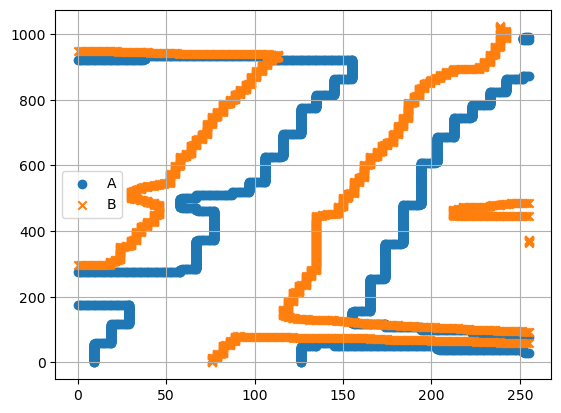

Performing laplacian ICP...
i-th iteration: 1 / 8 error: 45.318485197580266
i-th iteration: 2 / 8 error: 35.3477353557802
i-th iteration: 3 / 8 error: 32.74009356304852
i-th iteration: 4 / 8 error: 31.965815259174995
i-th iteration: 5 / 8 error: 31.47890990417254
i-th iteration: 6 / 8 error: 31.074200836667238
i-th iteration: 7 / 8 error: 30.688095777158445
i-th iteration: 8 / 8 error: 30.496523127581543


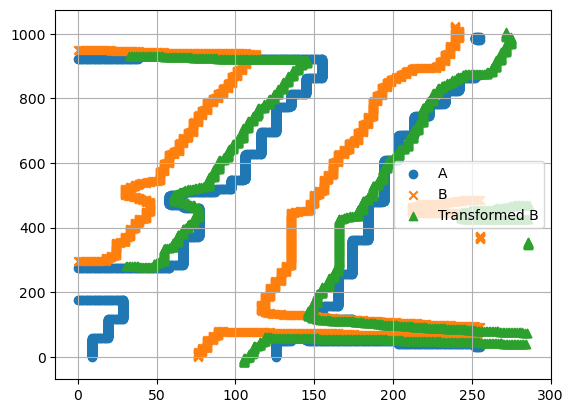

In [252]:
plot_data(A, B)

if ICP_version == "regular":
    R, T = icp(B, A, max_iterations=8, silent_mode=False)  # Get the transformed B directly
elif ICP_version == "laplacian":
    R, T = icp_laplacian(B, A, max_iterations=8, silent_mode=False)  # Get the transformed B directly
elif ICP_version == "scale-adaptive":
    R, T, s = scale_adaptive_ICP(A, B, iterations=20, tol=1e-8, silent_mode=False)
else:
    raise Exception("Incorrect ICP version!")
    
B_transformed_3 = np.dot(B, R.T) + T  # This should align B to A's position

plot_data(A, B, B_transformed_3)

h = create_homography(R, T)

#### 2. Transform each building footprint pixel to new position and black out previous position

In [253]:
copy_cropped_raster = np.array(cropped_raster[0:256, 0:1024], dtype=cropped_raster.dtype)

In [254]:
pixels = np.argwhere(rooftop_binary_morph[0:256, 0:1024] > 0).reshape(-1,1,2).astype(np.float32)

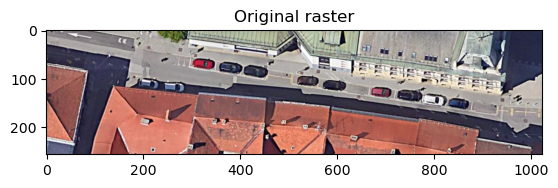

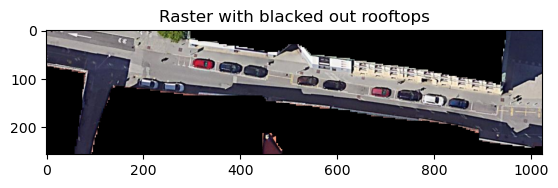

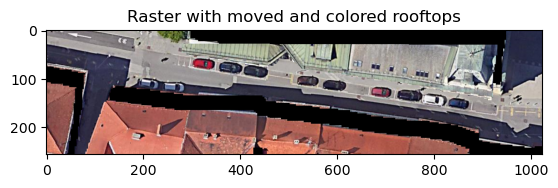

In [255]:
plt.title("Original raster")
plt.imshow(copy_cropped_raster)
plt.show()

old_pixel_colors = []
for pixel in pixels:
    old_pixel_color = np.array(copy_cropped_raster[int(pixel[0,0]), int(pixel[0,1])][:])
    old_pixel_colors.append(old_pixel_color)
    copy_cropped_raster[int(pixel[0,0]), int(pixel[0,1])][:] = 0 #black out those pixels


plt.title("Raster with blacked out rooftops")
plt.imshow(copy_cropped_raster)
plt.show()

transformed_pixels = cv2.perspectiveTransform(pixels, h)
for i, transformed_pixel in enumerate(transformed_pixels):
    new_pixel_position = [int(transformed_pixel[0,0]), int(transformed_pixel[0,1])]
    if new_pixel_position[0] >= 0 and new_pixel_position[0] < copy_cropped_raster.shape[0] and new_pixel_position[1] >= 0 and new_pixel_position[1] < copy_cropped_raster.shape[1]:
        copy_cropped_raster[new_pixel_position[0], new_pixel_position[1]] = old_pixel_colors[i]

plt.title("Raster with moved and colored rooftops")
plt.imshow(copy_cropped_raster)
plt.show()

#### a) On a complete image, split into patches

In [256]:
copy_cropped_raster = np.array(cropped_raster, dtype=cropped_raster.dtype)

copy_rooftop_binary_morph = np.array(rooftop_binary_morph)

In [257]:
unique_vals_in_cropped_shp_colored = np.unique(cropped_shp_colored)
for unique_val in unique_vals_in_cropped_shp_colored: #[46, 57] (zgradbi zgoraj levo od UM)
    if unique_val == 0: #skip background
        continue
    print("Working on shape with color ID:", unique_val, "/", unique_vals_in_cropped_shp_colored.shape[0])
    
    # Get row and column indices where value is 2
    rows, cols = np.where(cropped_shp_colored == unique_val)
    
    # Get bounding box coordinates
    pad = 1
    
    top = rows.min() - pad
    bottom = rows.max() + pad
    left = cols.min() - pad
    right = cols.max() + pad
    
    if top < 0:
        top = 0
    elif bottom >= cropped_shp_colored.shape[0]:
        bottom = cropped_shp_colored.shape[0]
        
    if left < 0:
        left = 0
    elif right >= cropped_shp_colored.shape[1]:
        right = cropped_shp_colored.shape[1]
    
    #DONT NEED THIS actually
    bbox_cropped_shp_colored = np.array(cropped_shp_colored[top:bottom, left:right])
    bbox_cropped_shp_colored[bbox_cropped_shp_colored != unique_val] = 0
    
    #plt.imshow(bbox_cropped_shp_colored)
    #plt.show()
    
    # 1. get homography matrix
    copy_rooftop_binary_morph_edges2 = np.array(rooftop_binary_morph_edges[top:bottom, left:right])
    copy_cropped_shp_edges2 = np.array(cropped_shp_edges[top:bottom, left:right]) #cropped_shp_edges_colored[top:bottom, left:right] <- individual footprints, cropped_shp_edges<- joined footprints in Ground Truth
    
    #optional step:
    #START optional - performance worse, don't really use
    """
    # Define a 3x3 kernel for the erosion (you can adjust this if needed)
    kernel = np.ones((3,3), np.uint8)
    # Dilate the image to expand it by one pixel all around
    bbox_cropped_shp_colored_dilated = cv2.dilate(bbox_cropped_shp_colored, kernel, iterations=1)
    #plt.imshow(copy_cropped_shp_edges2)
    #plt.show()
    
    copy_cropped_shp_edges2[bbox_cropped_shp_colored_dilated == 0] = 0
    
    #print("after")
    #plt.imshow(copy_cropped_shp_edges2)
    #plt.show()
    """
    #END optional
    
    #plt.imshow(copy_rooftop_binary_morph_edges2)
    #plt.show()
    
    #plt.imshow(copy_cropped_shp_edges2, cmap='gray')
    #plt.show()
    
    recognized_footprints_edge_points = np.argwhere(copy_rooftop_binary_morph_edges2 == 255)
    gt_footprints_edge_points = np.argwhere(copy_cropped_shp_edges2 == 255)
    B = recognized_footprints_edge_points
    A = gt_footprints_edge_points
    
    if len(B) == 0 or len(A) == 0: #if either B or A don't contain any recognized footprints, skip this patch
        print("skipping patch for building numbered:", unique_val)
        continue
    else:
        print("ICP working...")
        
    if ICP_version == "regular":
        R, T = icp(B, A, max_iterations=8, silent_mode=False)  # Get the transformed B directly
    elif ICP_version == "laplacian":
        R, T = icp_laplacian(B, A, max_iterations=8, silent_mode=False)  # Get the transformed B directly
        if R is None and T is None:
            print("skipping patch for building numbered:", unique_val)
            continue
    elif ICP_version == "scale-adaptive":
        R, T, s = scale_adaptive_ICP(A, B, iterations=20, tol=1e-8, silent_mode=False)
    else:
        raise Exception("Incorrect ICP version!")
        
    B_transformed_3 = np.dot(B, R.T) + T  # This should align B to A's position

    h = create_homography(R, T)
    print("ICP done")
    
    # 2. Transform each building footprint pixel to new position and black out previous position
    pixels = np.argwhere(copy_rooftop_binary_morph[top:bottom, left:right] > 0).reshape(-1,1,2).astype(np.float32)
    
    old_pixel_colors = []
    for pixel in pixels:
        old_pixel_color = np.array(copy_cropped_raster[top:bottom, left:right][int(pixel[0,0]), int(pixel[0,1])][:])
        old_pixel_colors.append(old_pixel_color)
        copy_cropped_raster[top:bottom, left:right][int(pixel[0,0]), int(pixel[0,1])][:] = 0 #black out those pixels

    transformed_pixels = cv2.perspectiveTransform(pixels, h).astype(np.int32)
    for k, transformed_pixel in enumerate(transformed_pixels): #### ????
        new_pixel_position = [transformed_pixel[0,0], transformed_pixel[0,1]]
        if new_pixel_position[0] >= 0 and new_pixel_position[0] < copy_cropped_raster[top:bottom, left:right].shape[0] and new_pixel_position[1] >= 0 and new_pixel_position[1] < copy_cropped_raster[top:bottom, left:right].shape[1]:
            copy_cropped_raster[top:bottom, left:right][new_pixel_position[0], new_pixel_position[1]] = old_pixel_colors[k]

Working on shape with color ID: 1 / 126
ICP working...
Performing laplacian ICP...
i-th iteration: 1 / 8 error: 7.026574746870848
i-th iteration: 2 / 8 error: 6.564808095164572
i-th iteration: 3 / 8 error: 6.345294263005828
i-th iteration: 4 / 8 error: 6.331083400700063
i-th iteration: 5 / 8 error: 6.418418873456478
i-th iteration: 6 / 8 error: 6.382333840237091
i-th iteration: 7 / 8 error: 6.241293391405691
i-th iteration: 8 / 8 error: 6.3951779334337715
ICP done
Working on shape with color ID: 2 / 126
skipping patch for building numbered: 2
Working on shape with color ID: 3 / 126
ICP working...
Performing laplacian ICP...
i-th iteration: 1 / 8 error: 37.404170147854295
i-th iteration: 2 / 8 error: 34.15706248845828
i-th iteration: 3 / 8 error: 32.275071736745225
i-th iteration: 4 / 8 error: 31.37141115993765
i-th iteration: 5 / 8 error: 31.294986604910576
i-th iteration: 6 / 8 error: 31.179981863888777
i-th iteration: 7 / 8 error: 31.178080100952794
i-th iteration: 8 / 8 error: 30.91

i-th iteration: 1 / 8 error: 25.70733337256801
i-th iteration: 2 / 8 error: 24.956972895560725
i-th iteration: 3 / 8 error: 24.767911464478523
i-th iteration: 4 / 8 error: 24.258640566433883
i-th iteration: 5 / 8 error: 24.160977905918067
i-th iteration: 6 / 8 error: 24.21250045391585
i-th iteration: 7 / 8 error: 24.23578906199679
i-th iteration: 8 / 8 error: 24.260772070165753
ICP done
Working on shape with color ID: 25 / 126
ICP working...
Performing laplacian ICP...
i-th iteration: 1 / 8 error: 13.83362635650176
i-th iteration: 2 / 8 error: 11.588234730296504
i-th iteration: 3 / 8 error: 10.403016911790768
i-th iteration: 4 / 8 error: 10.19531323051195
i-th iteration: 5 / 8 error: 9.944064899803536
i-th iteration: 6 / 8 error: 9.92905847637985
i-th iteration: 7 / 8 error: 9.991272874884837
i-th iteration: 8 / 8 error: 10.041605925851332
ICP done
Working on shape with color ID: 26 / 126
ICP working...
Performing laplacian ICP...
i-th iteration: 1 / 8 error: 12.385155646730134
i-th it

i-th iteration: 1 / 8 error: 17.981083690023436
i-th iteration: 2 / 8 error: 13.945649718589738
i-th iteration: 3 / 8 error: 12.716826735207512
i-th iteration: 4 / 8 error: 12.45657226781511
i-th iteration: 5 / 8 error: 12.289035843864522
i-th iteration: 6 / 8 error: 12.19607004514949
i-th iteration: 7 / 8 error: 12.165777080874937
i-th iteration: 8 / 8 error: 12.078552638056196
ICP done
Working on shape with color ID: 46 / 126
ICP working...
Performing laplacian ICP...
i-th iteration: 1 / 8 error: 26.167844598005992
i-th iteration: 2 / 8 error: 12.978747269728082
i-th iteration: 3 / 8 error: 11.172690193837296
i-th iteration: 4 / 8 error: 10.903211612967969
i-th iteration: 5 / 8 error: 10.666224031147
i-th iteration: 6 / 8 error: 10.4806129795783
i-th iteration: 7 / 8 error: 10.221514802674765
i-th iteration: 8 / 8 error: 9.911365522074398
ICP done
Working on shape with color ID: 47 / 126
ICP working...
Performing laplacian ICP...
i-th iteration: 1 / 8 error: 14.676580296477912
i-th i

i-th iteration: 1 / 8 error: 17.9861744648112
i-th iteration: 2 / 8 error: 15.100844856932177
i-th iteration: 3 / 8 error: 14.54131419886083
i-th iteration: 4 / 8 error: 14.411424860155964
i-th iteration: 5 / 8 error: 14.50709908977137
i-th iteration: 6 / 8 error: 14.475640500976471
i-th iteration: 7 / 8 error: 14.419496839473247
i-th iteration: 8 / 8 error: 14.287397150326301
ICP done
Working on shape with color ID: 65 / 126
ICP working...
Performing laplacian ICP...
i-th iteration: 1 / 8 error: 2.946981649986928
i-th iteration: 2 / 8 error: 2.8430934115076694
i-th iteration: 3 / 8 error: 2.808025298651069
i-th iteration: 4 / 8 error: 2.756202509665222
i-th iteration: 5 / 8 error: 2.7592156923727567
ICP done
Working on shape with color ID: 66 / 126
ICP working...
Performing laplacian ICP...
i-th iteration: 1 / 8 error: 27.79918421356894
i-th iteration: 2 / 8 error: 25.270411718549628
i-th iteration: 3 / 8 error: 25.164914691926736
i-th iteration: 4 / 8 error: 25.314484944187285
i-th i

i-th iteration: 4 / 8 error: 12.422426784530158
i-th iteration: 5 / 8 error: 11.997961181528847
i-th iteration: 6 / 8 error: 11.741093115607166
i-th iteration: 7 / 8 error: 11.655429727716857
i-th iteration: 8 / 8 error: 11.438817839893563
ICP done
Working on shape with color ID: 84 / 126
ICP working...
Performing laplacian ICP...
i-th iteration: 1 / 8 error: 27.97043658664771
i-th iteration: 2 / 8 error: 22.17796995085105
i-th iteration: 3 / 8 error: 19.029494538591074
i-th iteration: 4 / 8 error: 17.516366372712394
i-th iteration: 5 / 8 error: 17.311313163703865
i-th iteration: 6 / 8 error: 17.35383806618046
i-th iteration: 7 / 8 error: 17.252330577953643
i-th iteration: 8 / 8 error: 17.248031410836106
ICP done
Working on shape with color ID: 85 / 126
ICP working...
Performing laplacian ICP...
i-th iteration: 1 / 8 error: 23.479886520646755
i-th iteration: 2 / 8 error: 21.441332032788132
i-th iteration: 3 / 8 error: 20.98335114946218
i-th iteration: 4 / 8 error: 21.42779865846057
i-t

i-th iteration: 1 / 8 error: 17.440671376016155
i-th iteration: 2 / 8 error: 15.500860893640812
i-th iteration: 3 / 8 error: 15.215014040268375
i-th iteration: 4 / 8 error: 15.025426819370988
i-th iteration: 5 / 8 error: 14.932307150014175
i-th iteration: 6 / 8 error: 14.80116725179419
i-th iteration: 7 / 8 error: 14.700643258510425
i-th iteration: 8 / 8 error: 14.710934220261173
ICP done
Working on shape with color ID: 103 / 126
ICP working...
Performing laplacian ICP...
i-th iteration: 1 / 8 error: 41.64128055495394
i-th iteration: 2 / 8 error: 35.9128113467778
i-th iteration: 3 / 8 error: 32.81339808124709
i-th iteration: 4 / 8 error: 31.288093255267757
i-th iteration: 5 / 8 error: 30.71436375407211
i-th iteration: 6 / 8 error: 30.43942094590347
i-th iteration: 7 / 8 error: 30.094730122081486
i-th iteration: 8 / 8 error: 29.737586679472276
ICP done
Working on shape with color ID: 104 / 126
ICP working...
Performing laplacian ICP...
i-th iteration: 1 / 8 error: 24.796431839785775
i-t

i-th iteration: 5 / 8 error: 12.402819220173436
i-th iteration: 6 / 8 error: 12.25608214787135
i-th iteration: 7 / 8 error: 12.293389625574957
i-th iteration: 8 / 8 error: 12.21349132821211
ICP done
Working on shape with color ID: 120 / 126
ICP working...
Performing laplacian ICP...
i-th iteration: 1 / 8 error: 25.71198101539573
i-th iteration: 2 / 8 error: 22.697956042092876
i-th iteration: 3 / 8 error: 21.181659432738947
i-th iteration: 4 / 8 error: 20.911042914371144
i-th iteration: 5 / 8 error: 20.295337342937557
i-th iteration: 6 / 8 error: 20.206407625576652
i-th iteration: 7 / 8 error: 20.027818385345434
i-th iteration: 8 / 8 error: 20.0258105998417
ICP done
Working on shape with color ID: 121 / 126
ICP working...
Performing laplacian ICP...
i-th iteration: 1 / 8 error: 14.044418129573575
i-th iteration: 2 / 8 error: 12.756289675285316
i-th iteration: 3 / 8 error: 12.23761309212491
i-th iteration: 4 / 8 error: 11.965257169317988
i-th iteration: 5 / 8 error: 11.845128989058711
i-

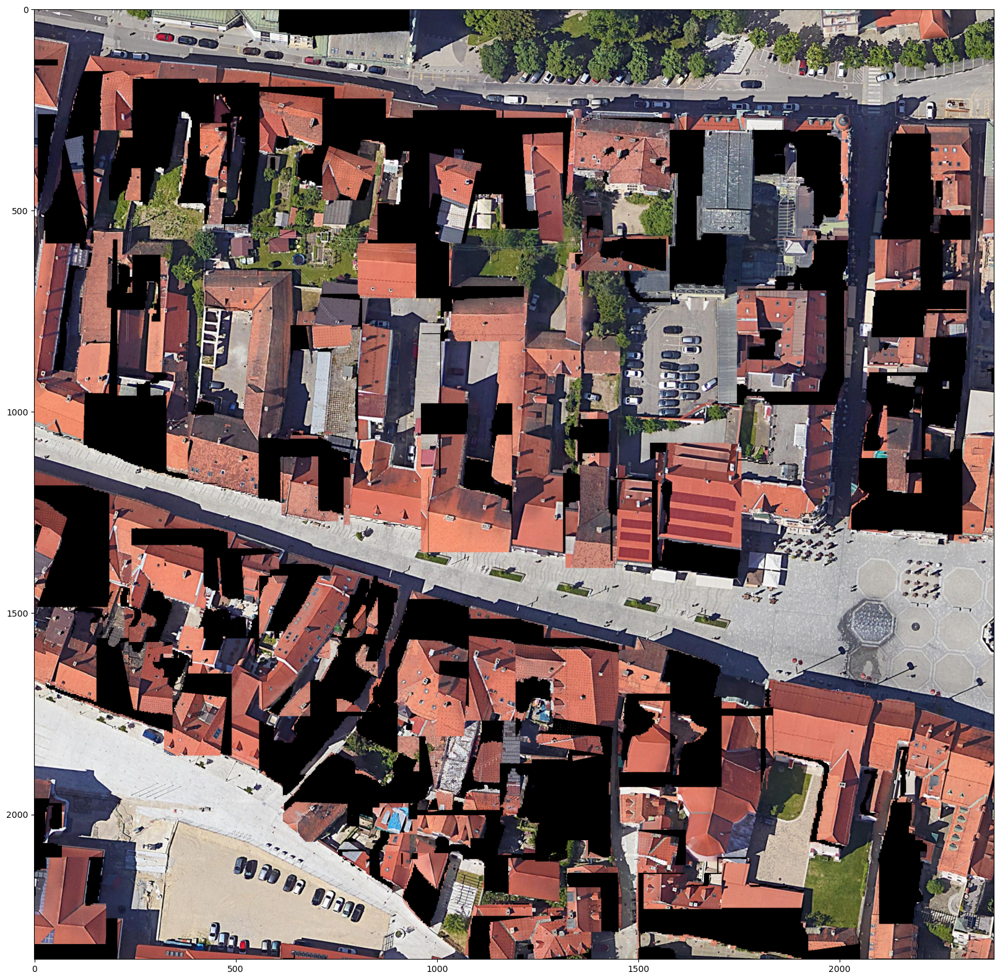

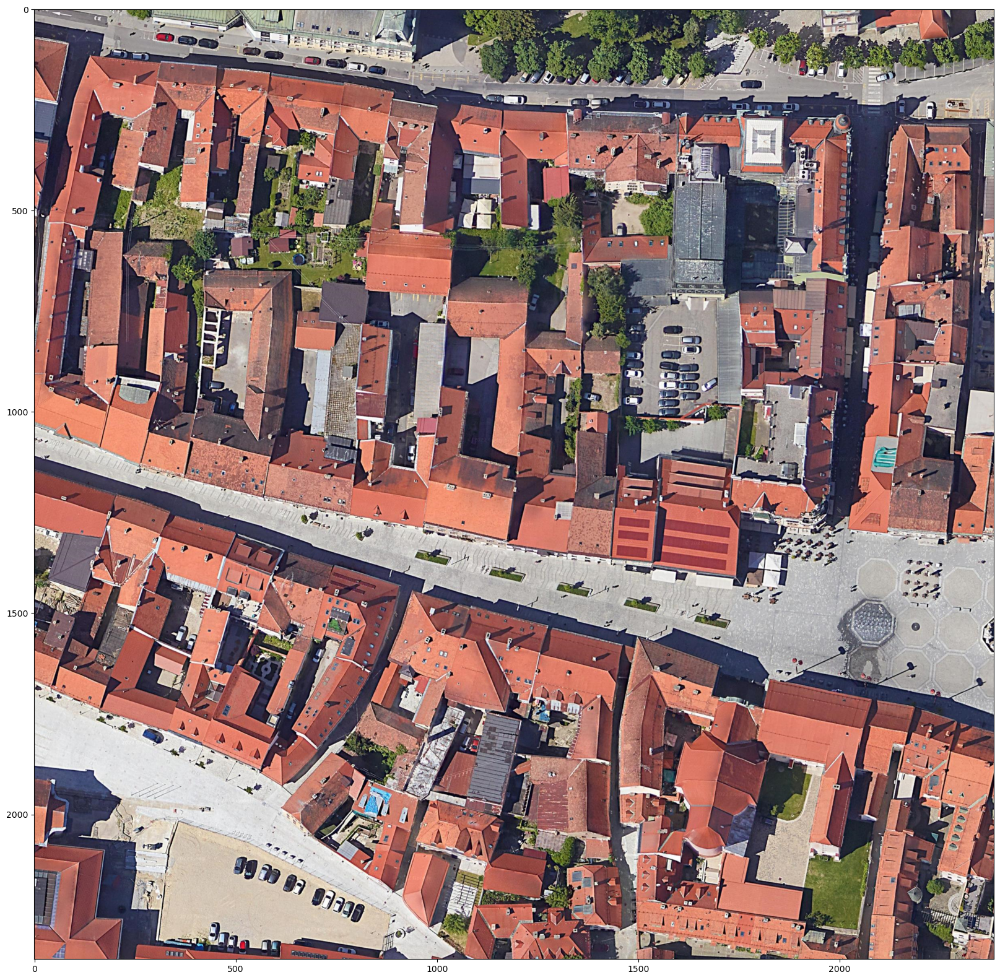

In [249]:
#scale adaptive ICP + hand made corrections in recognized data result
plt.figure(figsize=(20, 20))
plt.imshow(copy_cropped_raster)
plt.show()

plt.figure(figsize=(20, 20))
plt.imshow(cropped_raster)
plt.show()

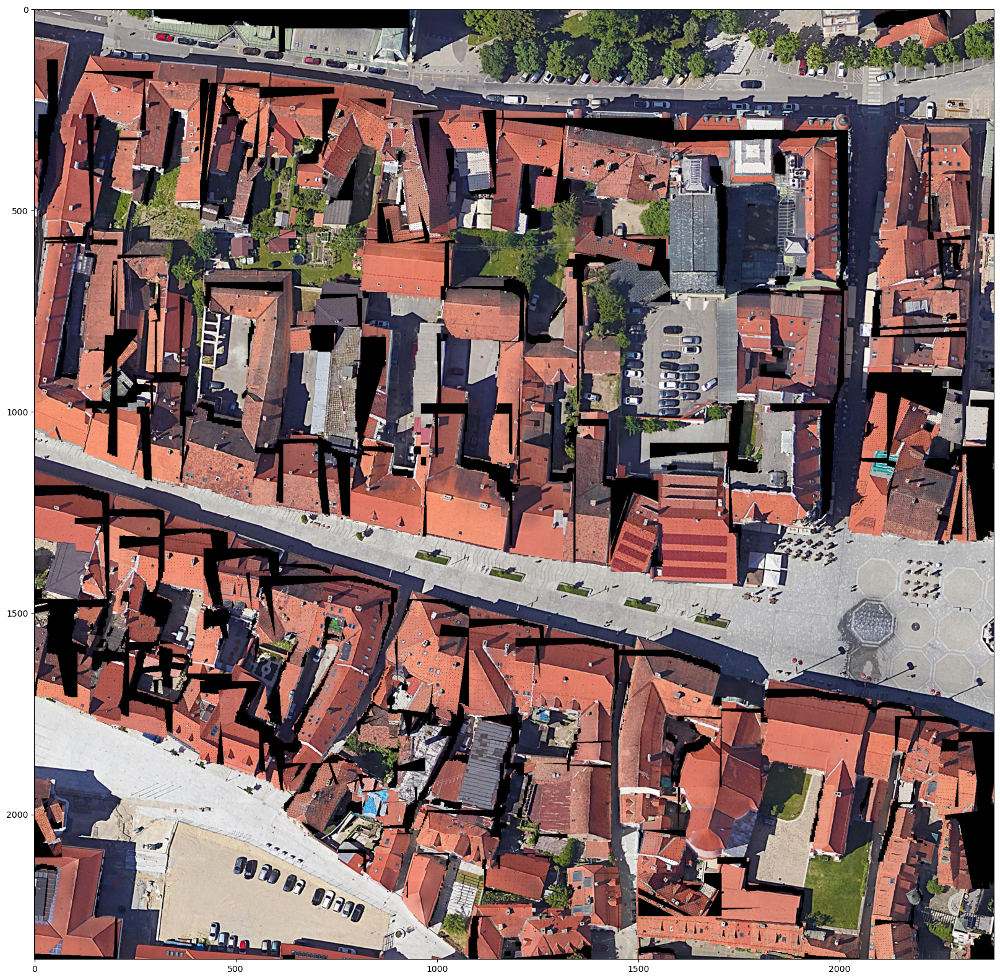

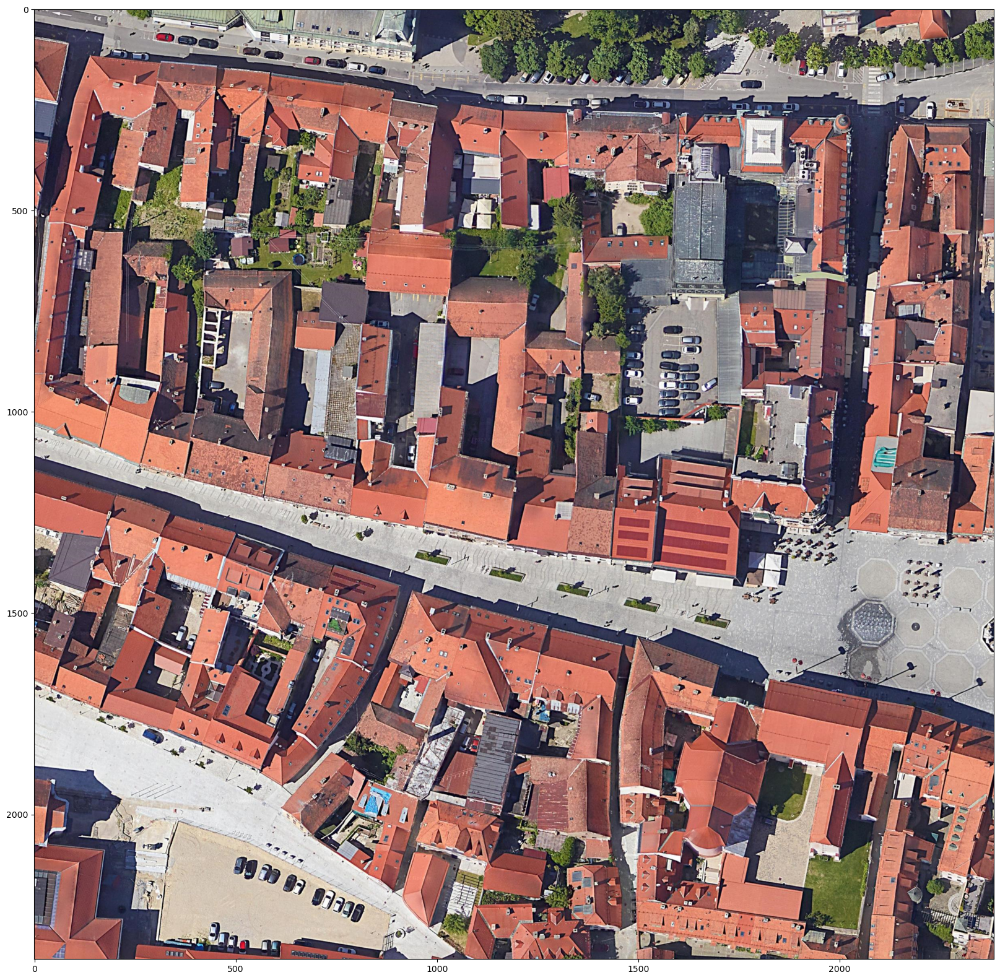

In [258]:
#laplacian ICP + hand made corrections in recognized data result (to je najbolj uspešno, sledi regular ICP, nato pa scale adaptive ICP - https://www.sciencedirect.com/science/article/pii/S1524070321000187)
plt.figure(figsize=(20, 20))
plt.imshow(copy_cropped_raster)
plt.show()

plt.figure(figsize=(20, 20))
plt.imshow(cropped_raster)
plt.show()

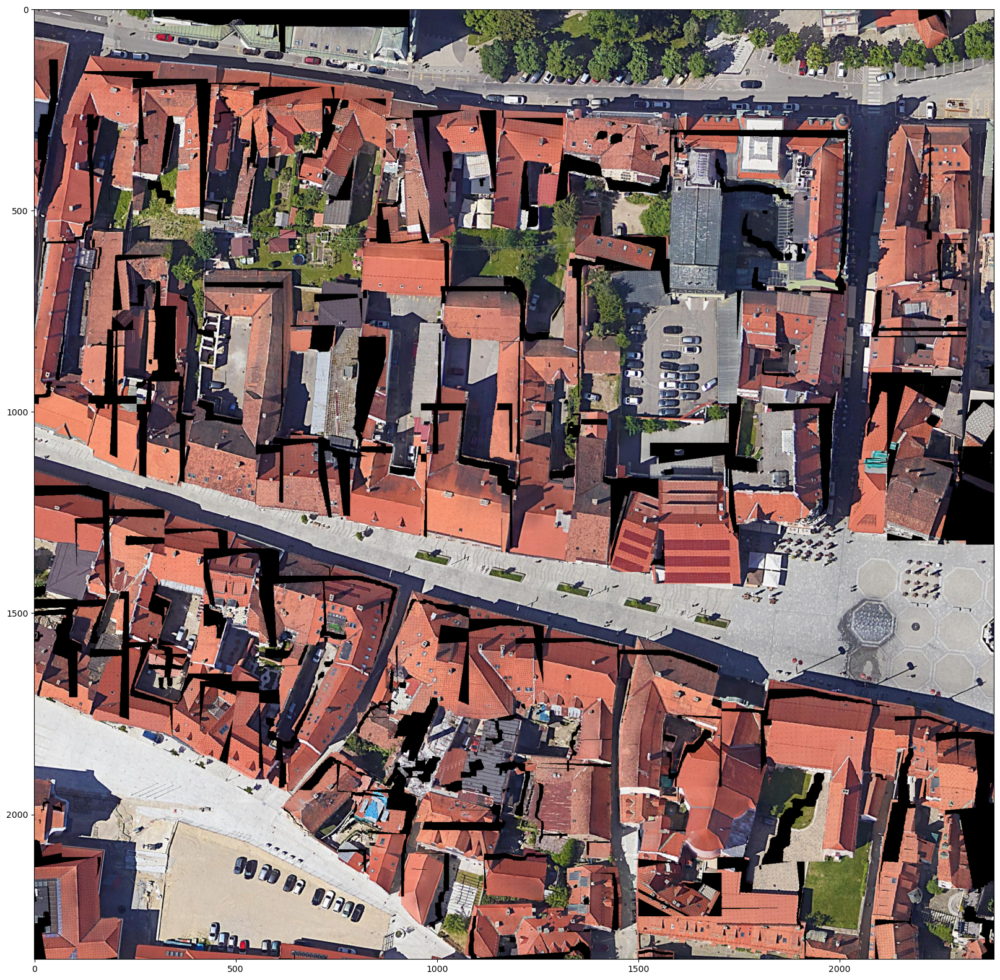

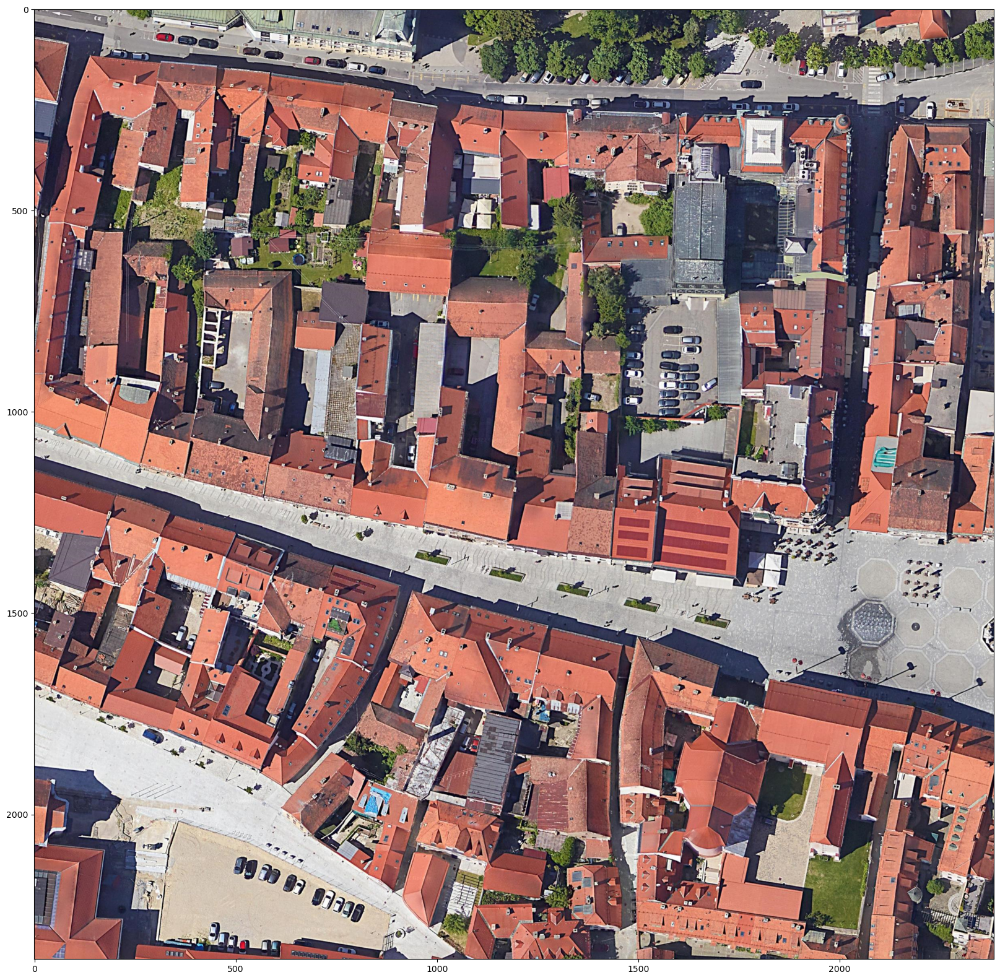

In [152]:
#regular ICP + hand made corrections in recognized data result
plt.figure(figsize=(20, 20))
plt.imshow(copy_cropped_raster)
plt.show()

plt.figure(figsize=(20, 20))
plt.imshow(cropped_raster)
plt.show()